In [1]:
import sys
import os
sys.path.append(os.path.abspath('').split('LiverStagePipeline')[-2] + 'LiverStagePipeline')

import numpy as np
import pandas as pd

import torch
import torch.optim as optim
from torch.utils.data import DataLoader

import get_models as get_models
from segmentation.AI.datasets import MicroscopyDataset
from segmentation.evaluate import Inferenceinator
from segmentation.conventional.cell_watershed import segment_cells_in_folder as conv_seg


from utils import setup, data_utils, cell_viewer
from feature_analysis import features, plot_features
from feature_analysis.cell_dataset import CellDataset
from feature_analysis.VAE_models import VAE
from feature_analysis.train import train_VAE
from feature_analysis import inference, dimensionality_reduction, plot_lowdim, evaluate_clusters

torch.set_default_dtype(torch.float64)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
if not torch.cuda.is_available():
    print("Using non-cuda device: {}".format(device))

In [2]:
# Global settings
session_name = '6c'#'FoI_1''6c'
pipeline_files_folder = '/mnt/DATA1/anton/pipeline_files'

# hsp_channel, dapi_channel = 1, 0 # lowres
hsp_channel, dapi_channel = 0, 2 # highres
threads = 20

In [3]:
paths = setup.setup(pipeline_files_folder, session_name=session_name)

# Segmentation

In [4]:
# settings
model_path = '/mnt/DATA1/anton/pipeline_files/segmentation/models/best_model.pth'
segmentation_batch_size = 10

# tif_folder = '/mnt/DATA1/anton/data/force_of_infection/tifs'
# tif_folder = '/mnt/DATA1/anton/data/parasite_annotated_dataset/images/lowres/NF175/D3'
tif_folder = '/mnt/DATA3/compounds/11C-organised'

In [5]:
image_paths = data_utils.get_paths(tif_folder) # list of paths to tif files

# print(len(image_paths))
# seg_stems = [os.path.basename(p) for p in data_utils.get_paths(paths['parasite_masks_folder'])]
# image_paths = [p for p in image_paths if not os.path.basename(p) in seg_stems]
# print(len(image_paths))

channels = [[dapi_channel, hsp_channel] for img_path in image_paths]

In [6]:
# # parasite segmentation
# segmentation_model, segmentation_model_output_parser = get_models.maskrcnn()
# segmentation_model.load_state_dict(torch.load(model_path))
# segmentation_model.to(device)

# image_dataset = MicroscopyDataset(image_paths=image_paths, channels=channels, groups=None, folder_normalize=True, rescale_img=(1040, 1392))
# image_loader = torch.utils.data.DataLoader(image_dataset, batch_size=segmentation_batch_size, num_workers=segmentation_batch_size, shuffle=True, collate_fn=data_utils.collate_fn)

# test_evaluator = Inferenceinator(image_loader, segmentation_model_output_parser, processes=segmentation_batch_size, evaluate=False, device=device)
# res = test_evaluator(segmentation_model, store_folder=paths['parasite_masks_folder'])

In [7]:
# # hepatocyte segmentation
# image_paths, parasite_mask_paths = data_utils.get_two_sets(tif_folder, paths['parasite_masks_folder'], common_subset=True, return_paths=True)
# assert len(image_paths) == len(channels)
# DAPI_channels = [dapi_channel] * len(image_paths)
# conv_seg(image_paths=image_paths, segmentation_folder=paths['hepatocyte_masks_folder'], parasite_mask_paths=parasite_mask_paths, threads=threads, channels=DAPI_channels, resize_shape=None, normalize=False, equalize_adapthist=12)

/mnt/DATA3/compounds/11C-organised/LDN/23B/C07/Exp2021023B-01-Scene-15-C7-C07_series_3_Exp2021023B-01-Scene-15-C7-C07


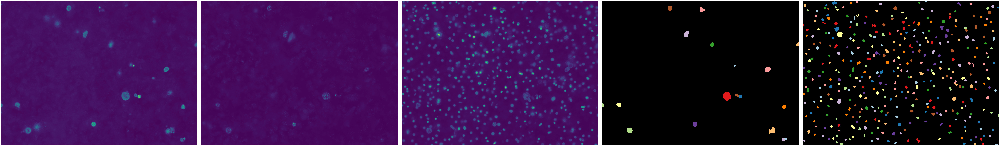

/mnt/DATA3/compounds/11C-organised/ForskSB/23B/B11/Exp2021023B-01-Scene-10-B11-B11_series_66_Exp2021023B-01-Scene-10-B11-B11


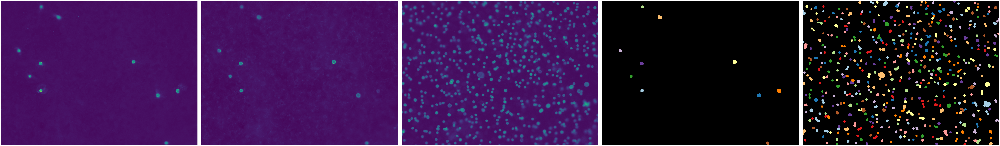

In [8]:
# visualization
cell_viewer.show_folder(tif_dir=tif_folder, seg_dirs=[paths['parasite_masks_folder'], paths['hepatocyte_masks_folder']], eval=False, num_rows=1, num_images=2)

# Feature extraction
Settings:
metadata_func: method that accepts a tif path and outputs relevant metadata (e.g. strain, day, resolution, etc.) in dictionary form. E.g. {'strain': 54, 'day': 7} feature_dict: dictionary indicating which features need to be computed, formatted as {ID: (name, feature_list)}, where ID is either the index of the channel or 'mask' for mask related features such as 'area' or 'solidity'. Name is the prefix for the computed feature in the final csv file. feature_list is a list of features. A feature_dict could be {'mask': ('', ['area', 'solidity']), 1: ('hsp', ['max_intensity', 'min_intensity'])}

In [9]:
# settings
feature_dict = features.default_feature_dict(hsp_channel=hsp_channel, dapi_channel=dapi_channel)

def annotated_metadata(tif_path):
    strain_mapping = {'NF135': 135, 'NF54': 54, 'NF175': 175}
    day_mapping = {'D3': 3, 'D5': 5, 'D7': 7}

    return {'strain': [strain_mapping[s] for s in strain_mapping.keys() if s in tif_path][0],
            'day': [day_mapping[s] for s in day_mapping.keys() if s in tif_path][0]}

def foi_metadata(tif_path):
    return {'strain': int(tif_path.split('/')[7][2:]), 'foi': tif_path.split('/')[8], 'foi_ratio': int(tif_path.split('/')[8].strip('h').split('s')[0]) / int(tif_path.split('/')[8].strip('h').split('s')[1])}

def sixc_metadata(tif_path):
    return {'drug': tif_path.split('/')[5]}

metadata_func = sixc_metadata

print(feature_dict)

{'mask': ('', ['area', 'area_convex', 'area_filled', 'axis_major_length', 'axis_minor_length', 'eccentricity', 'equivalent_diameter_area', 'extent', 'feret_diameter_max', 'perimeter', 'perimeter_crofton', 'solidity', 'avg_(1)_neighbours_distance', 'avg_(3)_neighbours_distance', 'avg_(5)_neighbours_distance', 'avg_(7)_neighbours_distance', 'parasites_within_(100)px', 'parasites_within_(300)px', 'parasites_within_(600)px', 'parasites_within_(900)px', 'parasites_within_(1200)px', 'parasites_within_(2000)px', 'avg_(1)_nearest_hepatocytes_distance', 'avg_(3)_nearest_hepatocytes_distance', 'avg_(5)_nearest_hepatocytes_distance', 'avg_(7)_nearest_hepatocytes_distance', 'avg_(10)_nearest_hepatocytes_distance', 'avg_(15)_nearest_hepatocytes_distance', 'avg_(20)_nearest_hepatocytes_distance', 'avg_(50)_nearest_hepatocytes_distance', 'avg_(100)_nearest_hepatocytes_distance', 'num_hepatocytes_in_(100)px_radius', 'num_hepatocytes_in_(300)px_radius', 'num_hepatocytes_in_(600)px_radius', 'num_hepatoc

In [10]:
# # feature extraction
# features.collect_features_from_folder(tif_folder=tif_folder, parasite_mask_folder=paths['parasite_masks_folder'], feature_dict=feature_dict, hepatocyte_mask_folder=paths['hepatocyte_masks_folder'], 
#                                       csv_path=paths['feature_file'], metadata_func=metadata_func, workers=threads)


# VAE 

In [11]:
# VAE train settings
hidden_dim = 250
latent_dim = 10
learning_rate = 0.001
batch_size = 48
epochs = 20
VAE_mode = 'vanilla'
beta = None
non_feature_columns = ['file', 'label', 'drug']#['file', 'label', 'foi', 'foi_ratio', 'strain']#

vae_identifier = '{}_{}LD_{}-VAE_{}epochs'.format(session_name, latent_dim, VAE_mode, epochs)

In [12]:
# Setting some paths
model_path = os.path.join(paths['FA_models_folder'], '{}.pth'.format(vae_identifier))
latent_space_path = os.path.join(paths['FA_latent_spaces_folder'], '{}.csv'.format(vae_identifier))
embeddings_path = os.path.join(paths['FA_embeddings_folder'], '{}.csv'.format(vae_identifier))

#### Creating the dataloaders
df = pd.read_csv(paths['feature_file'])
msk = np.random.rand(len(df)) < 0.8
train_df = df[msk]
test_df = df[~msk]

train_ds = CellDataset(train_df, non_feature_columns=non_feature_columns)
test_ds = CellDataset(test_df, non_feature_columns=non_feature_columns)

train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_ds, batch_size=batch_size, shuffle=True)

### Training the VAE
model = VAE(len(train_ds.features.columns), hidden_dim, latent_dim, mode=VAE_mode, beta=beta) # create VAE model
optimizer = optim.Adam(model.parameters(), lr=learning_rate) # define optimizer

# train_VAE(model, train_loader, test_loader, epochs, optimizer, model_path, device)

In [ ]:
# ## inference
# model.load_state_dict(torch.load(model_path)) # load best performing version of model

# complete_ds = CellDataset(df, non_feature_columns=non_feature_columns)
# complete_loader = DataLoader(complete_ds, batch_size=batch_size, shuffle=False)

# latent_space_df = inference.get_latent_embedding(model, complete_loader, device, latent_space_path=latent_space_path)

# Comparing groups

In [14]:
# Dimension reduction settings
dimensionality_reducer = 'umap'

comparison_groups = ['drug']#['strain', 'foi']#
marker_size = 12
alpha = 0.3

label_settings = {'foi': 
                        [['8s1h', '$\dfrac{8}{1}$'], 
                        ['4s1h', '$\dfrac{4}{1}$'],
                        ['2s1h', '$\dfrac{2}{1}$'],
                        ['1s1h', '$\dfrac{1}{1}$'],
                        ['1s2h', '$\dfrac{1}{2}$'],
                        ['1s4h', '$\dfrac{1}{4}$'],
                        ['1s8h', '$\dfrac{1}{8}$'],
                        ['1s16h', '$\dfrac{1}{16}$'],
                        ['1s32h', '$\dfrac{1}{32}$']],
                   'strain': 
                   [
                    ['54.0', 'NF54'],
                    ['135.0', 'NF135'],
                    ['175.0', 'NF175']
                   ]
                    }

gradual = {'foi': True, 'strain': False, 'drug': False}



colormaps = {'foi': 'viridis', 'strain': 'Dark2', 'drug': 'Paired'}



In [ ]:
# Dimensionality reduction
# dimensionality_reduction.reduce(dimensionality_reducer, latent_space_df, save_path=embeddings_path)

,Dimension 0,Dimension 1
0,-1.796390,5.358340
1,5.660486,3.820914
2,0.939890,6.886361
3,-2.742279,0.075105
4,-3.402493,-1.757424
...,...,...
215987,-1.123979,10.292426
215988,4.700855,6.294004
215989,-0.962799,7.629332
215990,-2.007198,9.586488


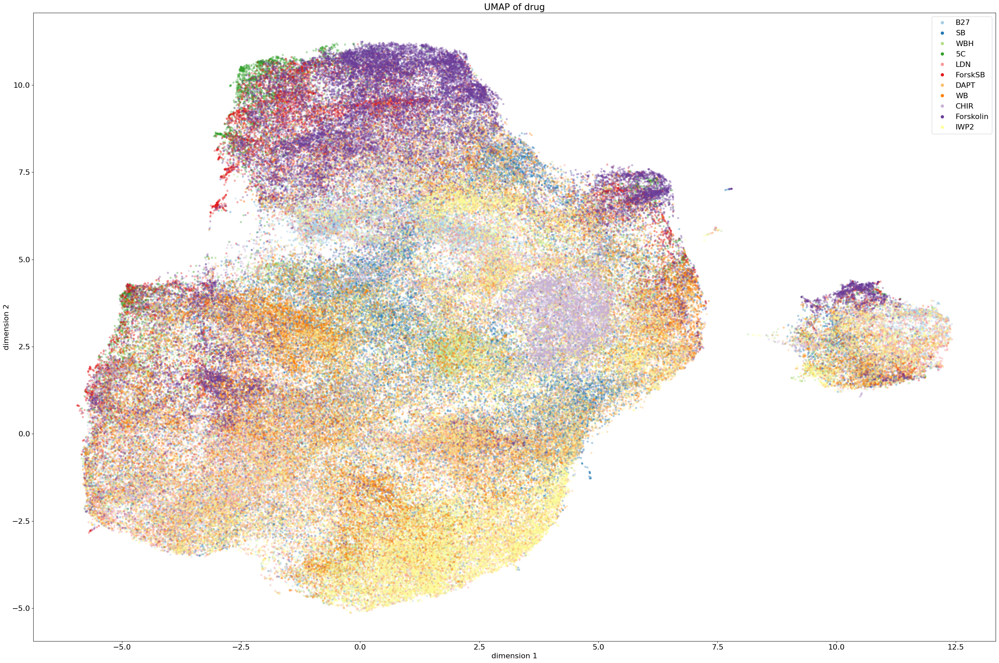

In [15]:
# Dimensionality reduction plotting
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_plots_folder'], '{}_{}-of-{}.png'.format(vae_identifier, dimensionality_reducer.upper(), feature))
    title = '{} of {}'.format(dimensionality_reducer.upper(), feature)
    labels = df[feature]
    ls = label_settings[feature] if label_settings and feature in label_settings.keys() else None
    plot_lowdim.plot(embeddings_path, labels, title=title, save_path=figure_path, show=True, marker_size=marker_size, alpha=alpha, colormap=colormaps[feature], label_settings=ls, gradual=gradual[feature])

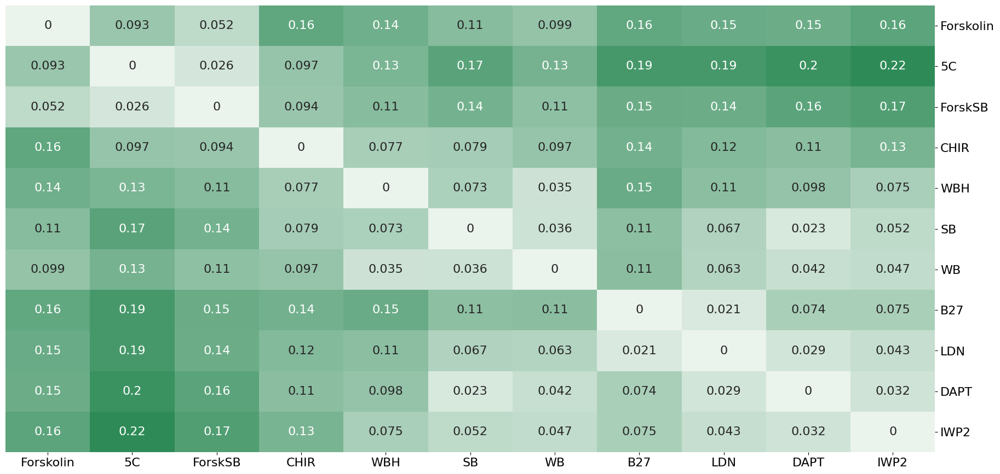

In [16]:
# Generating distance matrices
latent_space_df = pd.read_csv(latent_space_path)
for feature in comparison_groups:
    figure_path = os.path.join(paths['FA_latent_space_matrices_folder'], '{}_silhouette_scores_of_{}.png'.format(vae_identifier, feature))
    labels = [str(l) for l in df[feature]]
    mean, scores = evaluate_clusters.get_sillhouette_scores(latent_space_df, labels)
    ls = label_settings[feature] if label_settings and feature in label_settings.keys() else None
    evaluate_clusters.plot_distance_matrix(scores, show=True, save_path=figure_path, label_settings=ls)

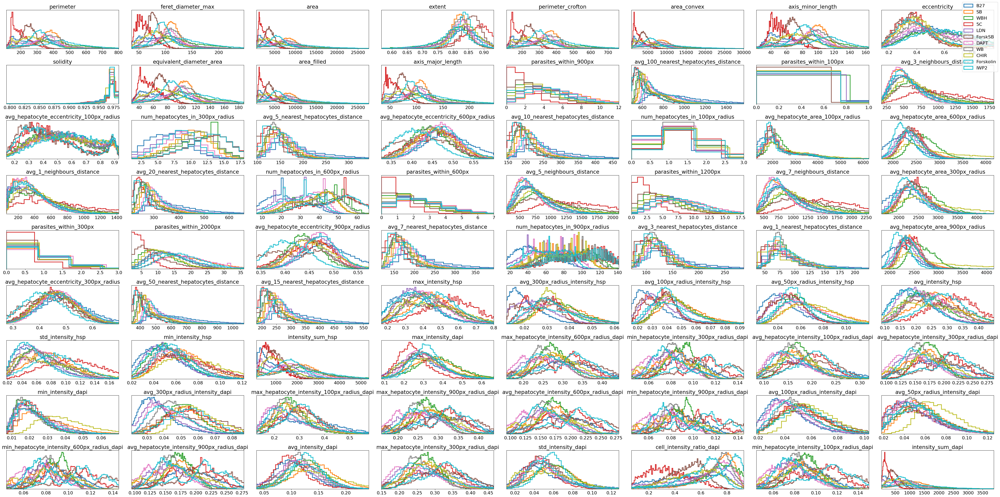

In [17]:

features_df = df.drop(columns=non_feature_columns)

for grouping in comparison_groups:
    labels = df[grouping]
    if label_settings and grouping in label_settings.keys():
        label_settings_dict = {l[0]: l[1] for l in label_settings[grouping]}
        labels = [label_settings_dict[str(l)] for l in labels]
        
    plot_features.multiplot(features=features_df, labels=labels, nrows=9, nbins=120)